In [8]:
import numpy as np
import cv2, glob, os, re
import pandas as pd
import pylab as plt
from xml.etree import ElementTree as et
import pickle

## flip 正畸

## 将图片整理成字典

In [9]:
# 分段图放在这里
# 路径中不要有中文字符
slices_img_path = r'D:\pic\tupian'

In [10]:
slice_img_list = glob.glob(os.path.join(slices_img_path, r'*H.jpg'))

pic_dict = {re.split('_', os.path.basename(k))[0]:{} for k in slice_img_list}
for p in slice_img_list:
    pic_dict[re.split('_', os.path.basename(p))[0]][re.findall('([A,B,C]\d)', p)[0]] = p

In [11]:
def undistort(img, col):
    '''
    恢复图像的径向畸变
    '''
    global camera_parameter_pkl_path, distort_matrix
    camera_parameter_pkl_path = './utils/ats_camera_all.pkl'
    try:
        distort_matrix
    except:
        distort_matrix = pickle.load(open(camera_parameter_pkl_path, "rb" )) 
    
    
    mtx,dist = distort_matrix["camera"+col]["mtx"],distort_matrix["camera"+col]["dist"]
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    return dst

In [12]:
pic_dict['11912030971534']

{'A1': 'D:\\pic\\tupian\\11912030971534_A1H.jpg',
 'A2': 'D:\\pic\\tupian\\11912030971534_A2H.jpg',
 'A3': 'D:\\pic\\tupian\\11912030971534_A3H.jpg',
 'A4': 'D:\\pic\\tupian\\11912030971534_A4H.jpg',
 'B1': 'D:\\pic\\tupian\\11912030971534_B1H.jpg',
 'B2': 'D:\\pic\\tupian\\11912030971534_B2H.jpg',
 'B3': 'D:\\pic\\tupian\\11912030971534_B3H.jpg',
 'B4': 'D:\\pic\\tupian\\11912030971534_B4H.jpg',
 'C1': 'D:\\pic\\tupian\\11912030971534_C1H.jpg',
 'C2': 'D:\\pic\\tupian\\11912030971534_C2H.jpg',
 'C3': 'D:\\pic\\tupian\\11912030971534_C3H.jpg',
 'C4': 'D:\\pic\\tupian\\11912030971534_C4H.jpg'}

## 生成golden unit

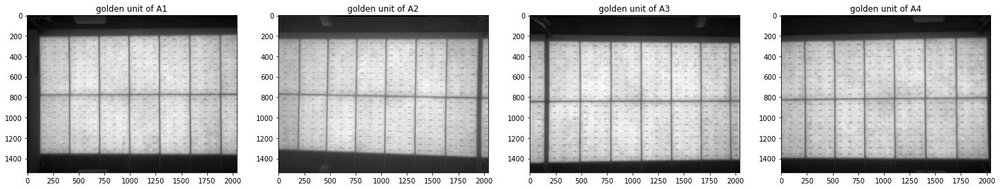

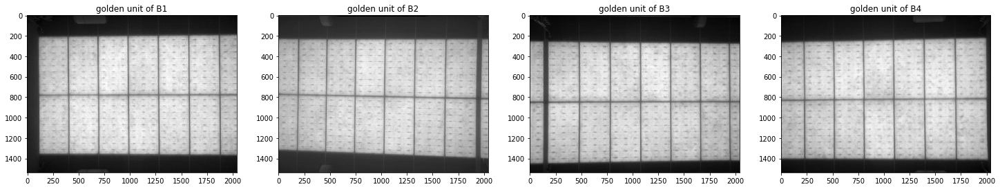

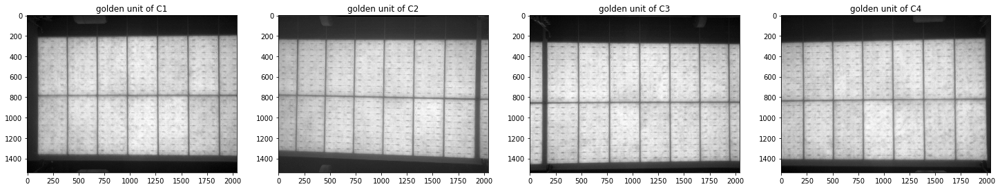

In [13]:
plt.rc('figure', figsize = (25, 8))
GOLDEN_UNIT_DICT = {}
for s in ['A', 'B', 'C']:
    for i in range(1,5):
        piece1 = []
        for v in pic_dict.values():
            piece1.append(undistort(cv2.flip(cv2.imread(v['%s%i' % (s, i)], 0), 0),str(i)))
        piece1 = np.array(piece1)
        gu_piece1 = piece1.mean(0)
        # 构建一次金字塔
        GOLDEN_UNIT_DICT['%s%i' % (s, i)] = cv2.pyrDown(gu_piece1.astype(np.uint8))
        plt.subplot(1, 4, i)
        plt.title('golden unit of %s%i' % (s, i))
        plt.imshow(gu_piece1, 'gray')
        cv2.imwrite('./golden_units/longi_M2L2_60_%s%i.jpg' % (s, i), gu_piece1)
        if i == 4:
            plt.show()

## 下一步：把Golden unit下载下来，打标签~
golden unit保存在ipynb所在文件夹的golden_units文件夹里面。<br>
**标签需知**：<br>
用labelimg打框，保证框的左上角点对齐角点位置。<br>
千万对齐不要打歪<br>

## 根据打的标签，生成golden_corners
把打好的标签上传上来。运行下面cell，观察一下是否点都是对的，以及数字是否是顺时针0123的顺序。

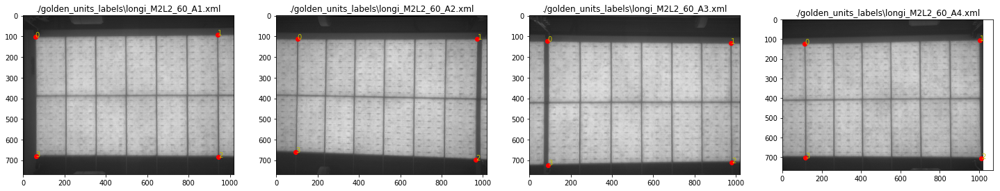

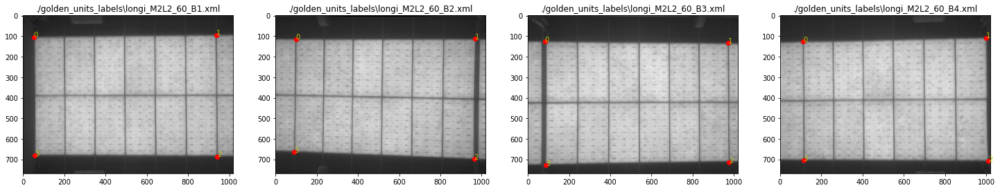

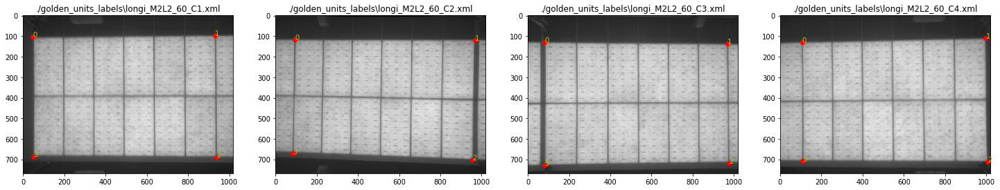

In [14]:
#get corners
def parse_objs_from_xml(xml_file):
    with open(xml_file) as f:
        tree = et.parse(f)
        root = tree.getroot()
    objs = []
    for o in tree.findall('object'):
        obj = {}
        obj['name'] = o.find('name').text
        obj['bndbox'] = []
        for pos in ['xmin', 'ymin', 'xmax', 'ymax']:
            obj['bndbox'].append(int(o.find('bndbox').find(pos).text))
        objs.append(obj)

    return objs

def reorg_dots(dots):
    dots = np.array(dots)
    sumxy = dots.sum(1)
    lt = dots[sumxy.argmin()]
    rd = dots[sumxy.argmax()]
    others = dots[np.argsort(sumxy)[1:-1]]
#     print(others)
    rt = others[others[:, 0].argmax()]
    ld = others[others[:, 0].argmin()]
    
    return np.array([lt, rt, rd, ld])

GOLDEN_CORNER_DICT = {}
k = 0
for xml in glob.glob(r'./golden_units_labels/*.xml'):
    objs = parse_objs_from_xml(xml)
    img = cv2.imread(r'./golden_units/%s.jpg' % os.path.basename(xml).split('.')[0])
    plt.subplot(1, 4, k % 4 + 1)
    plt.imshow(cv2.pyrDown(img), 'gray')
    plt.title(xml)
    
    corners = np.array([obj['bndbox'][:2] for obj in objs])
    corners = reorg_dots(corners)
    corners = np.uint(corners / 2)
#     print(xml.split('.')[1])
    GOLDEN_CORNER_DICT['%s' % xml.split('.')[1][-2:]] = corners
    i = 0
    for x, y in corners:
#         plt.scatter(x, y, c = 'r')
        plt.annotate(str(i), xy = (x, y), color = 'y')
        i += 1
    xs, ys = corners.T
    plt.scatter(xs, ys, c = 'r')
    k += 1
    if k % 4 == 0:
        plt.show()

## 将GOLDEN_UNIT和GOLDEN_CORNER写入配置文件pkl

In [8]:
golden_parameters = {"GOLDEN_UNIT_DICT": GOLDEN_UNIT_DICT, "GOLDEN_CORNER_DICT": GOLDEN_CORNER_DICT}
with open(r'./utils/ats_concat_parameters_72_1213_sz_dj.pkl', 'wb') as f:
    pickle.dump(golden_parameters, f)

## 下面是inference部分的集成测试

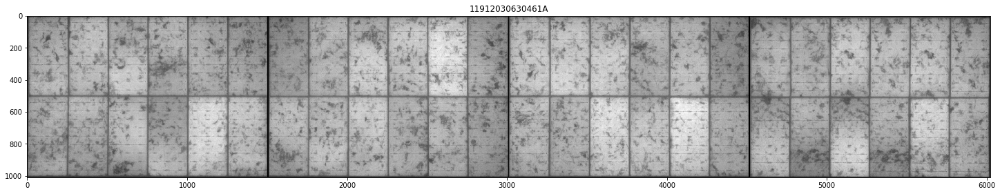

0.4540


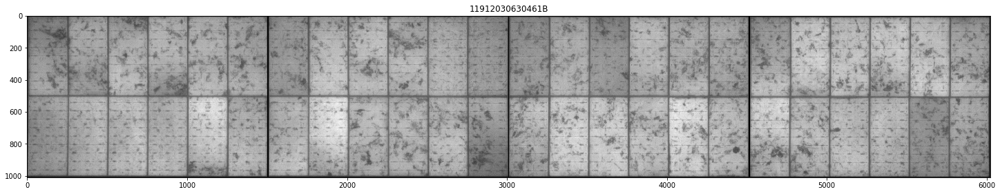

0.4730


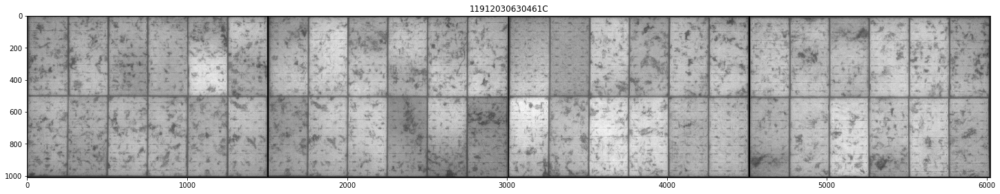

0.5030


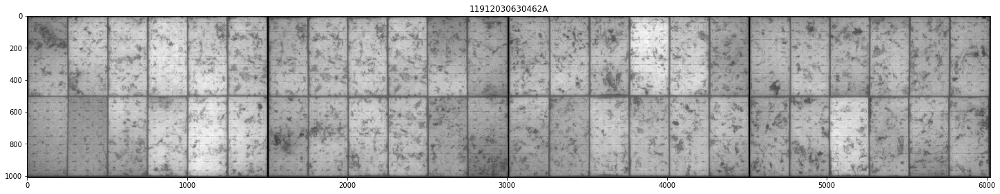

0.4630


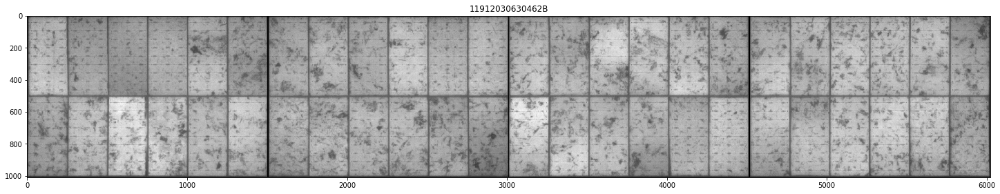

0.5300


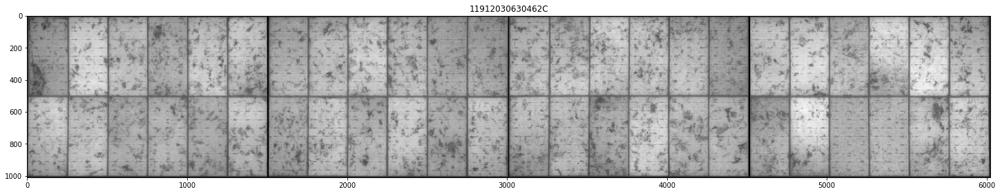

0.4760


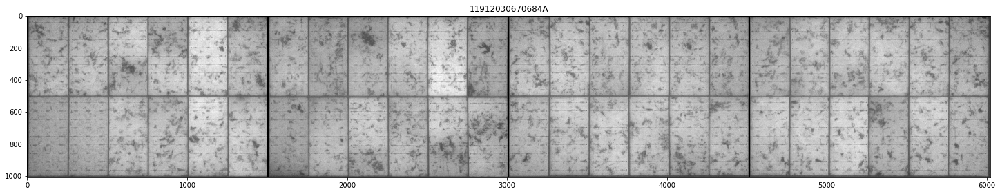

0.5920


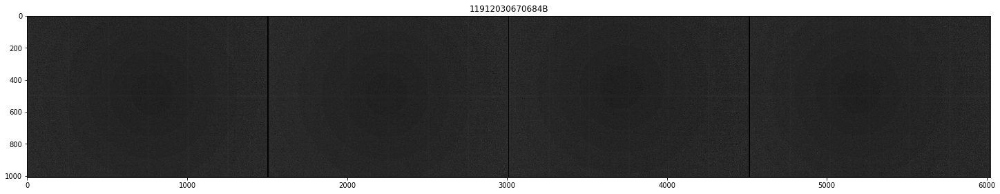

0.5750


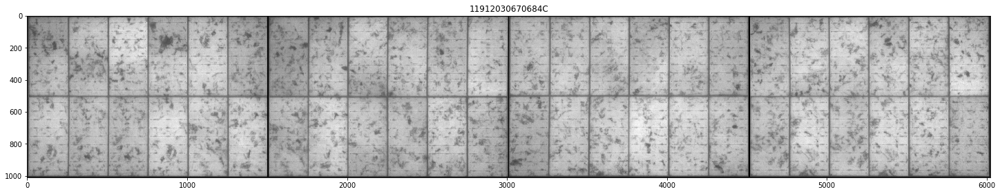

0.5420


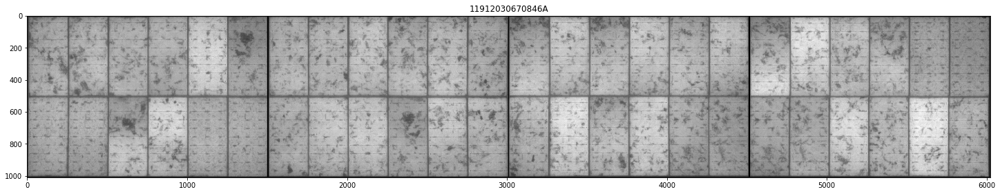

0.5520


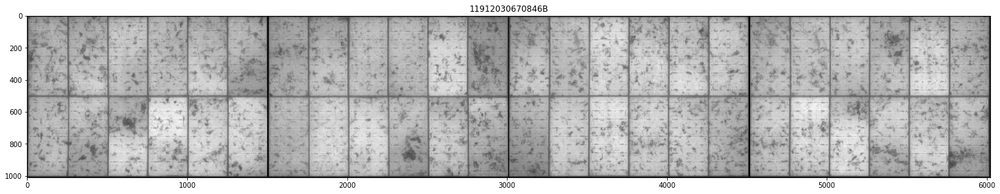

0.5340


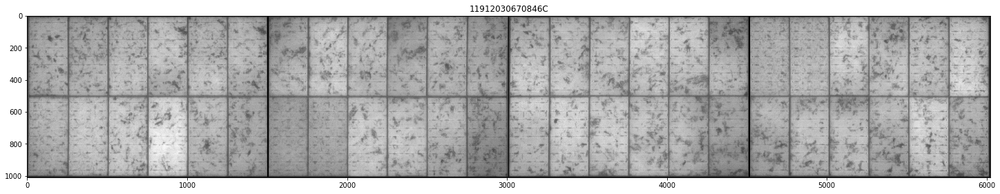

0.5740


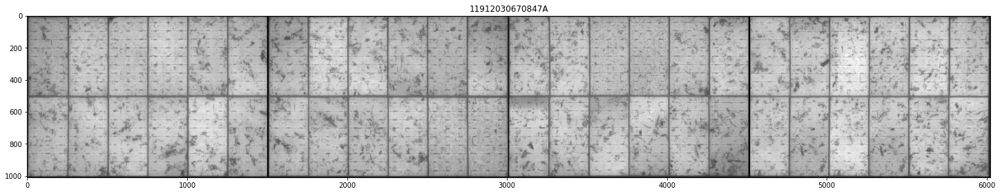

0.5590


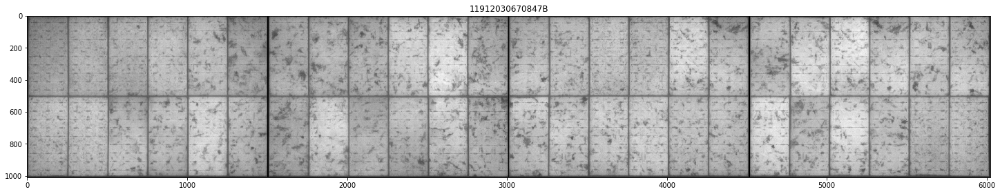

0.5780


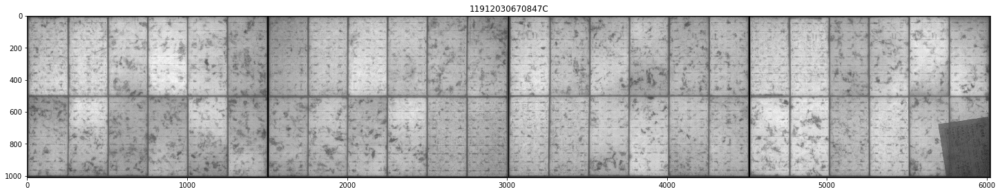

0.5450


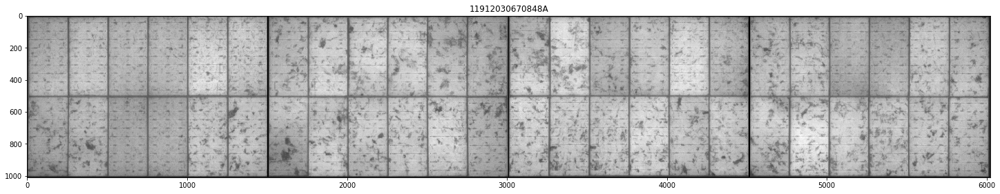

0.5500


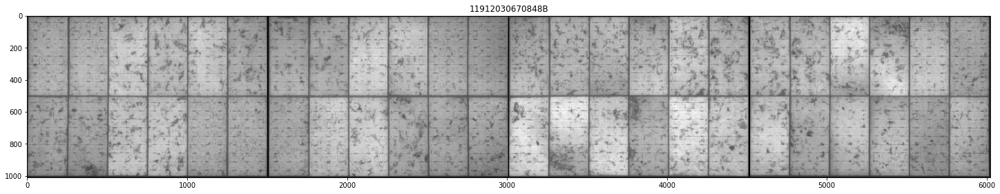

0.5560


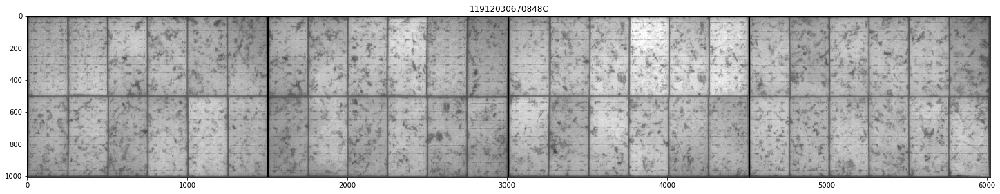

0.5330


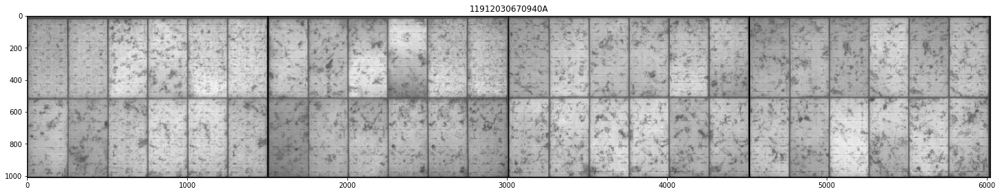

0.5240


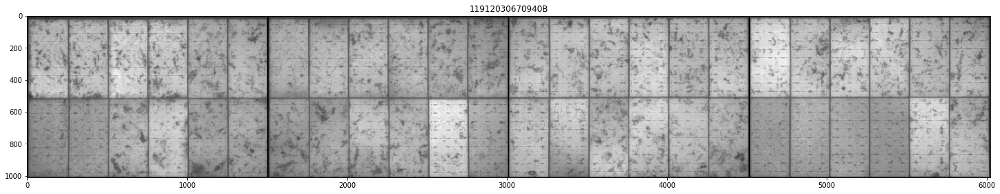

0.5250


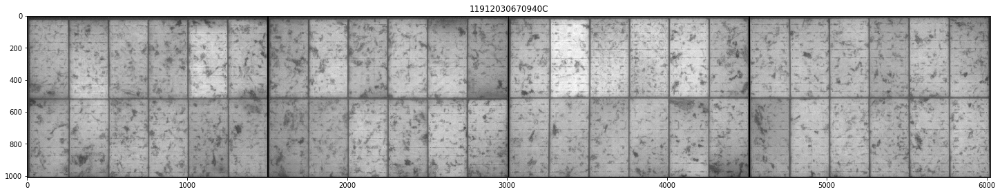

0.5440


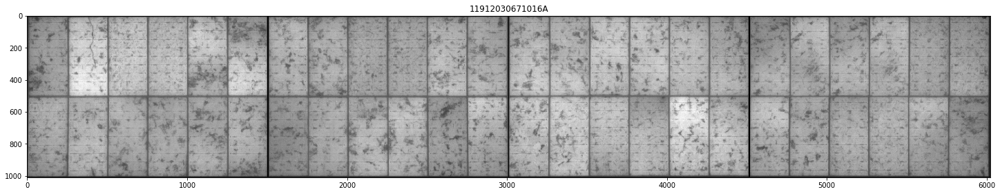

0.5250


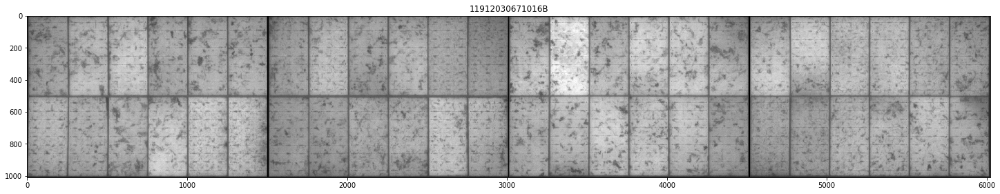

0.5520


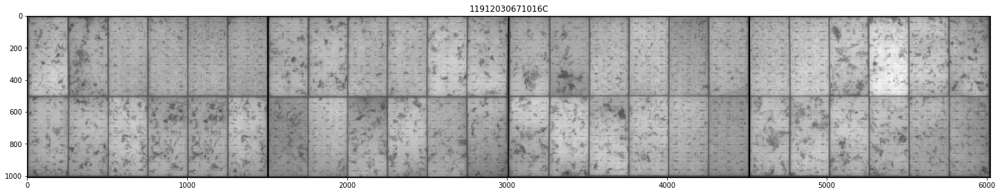

0.5290


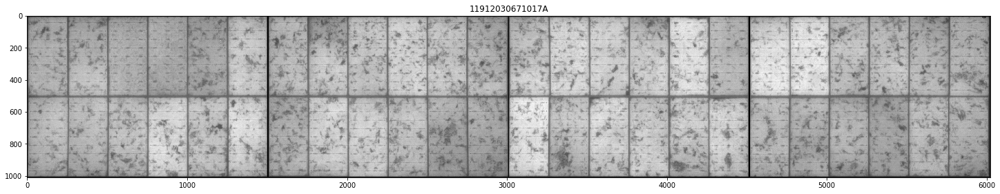

0.5590


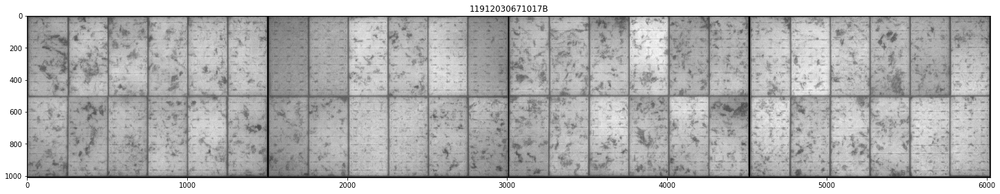

0.5360


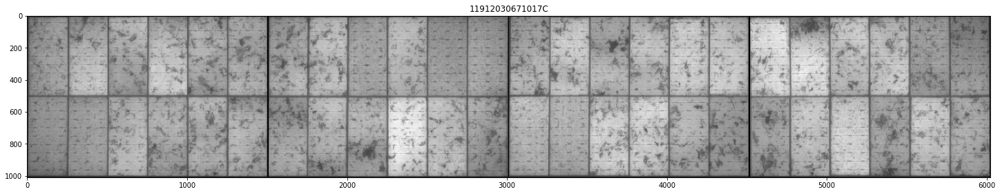

0.5270


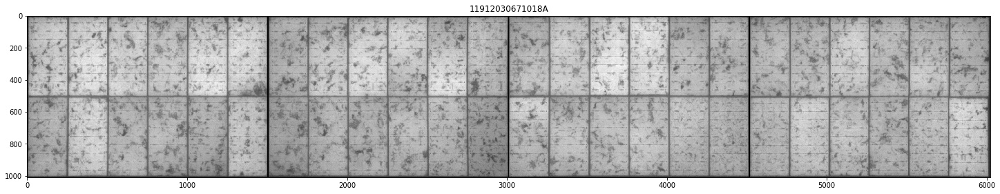

0.5310


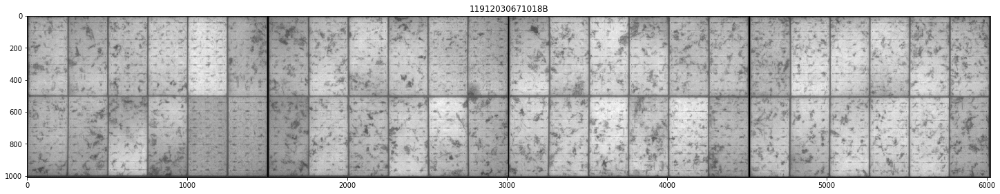

0.5400


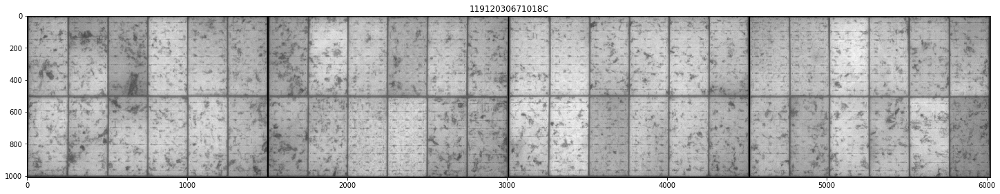

0.5750


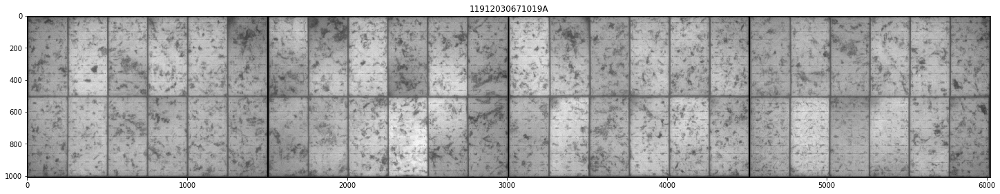

0.5240


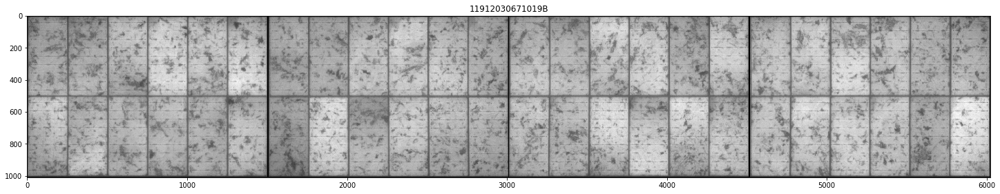

0.5280


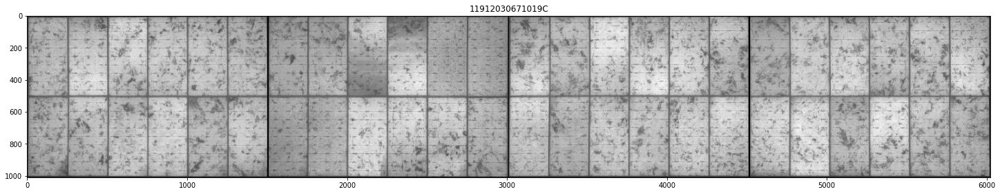

0.5650


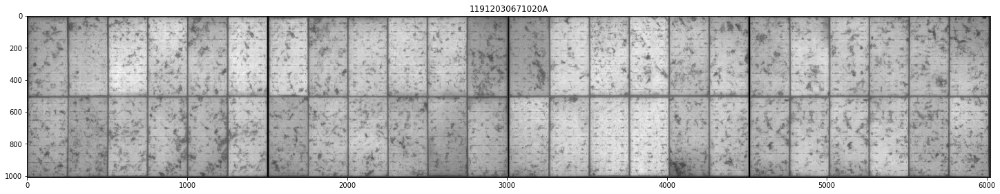

0.5280


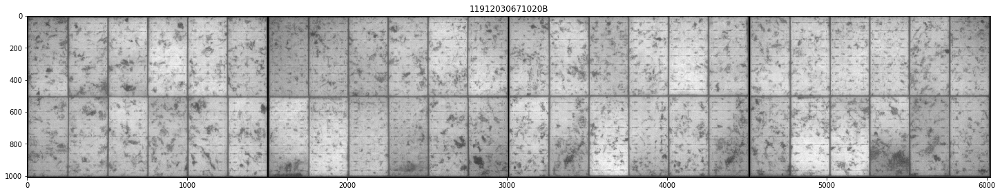

0.5320


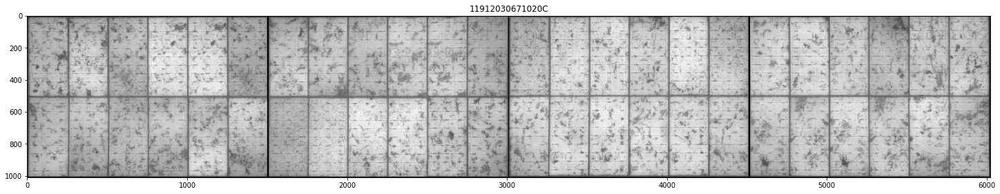

0.5380


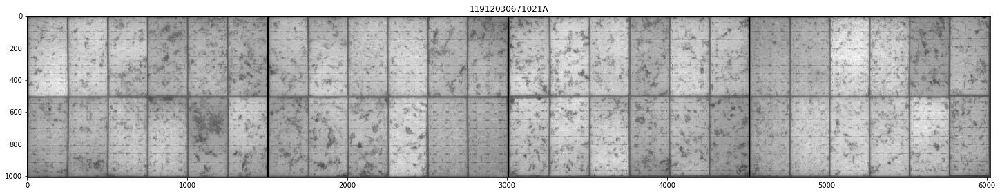

0.5470


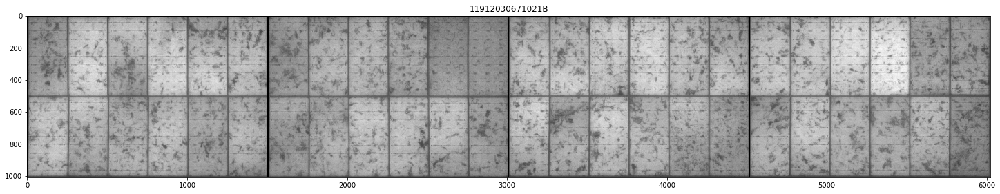

0.5400


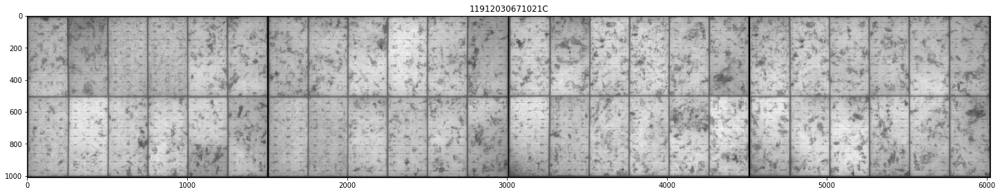

0.5540


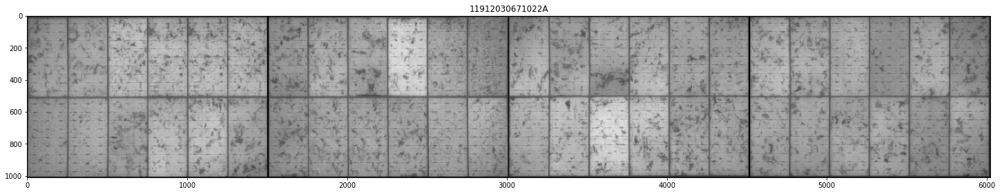

0.5630


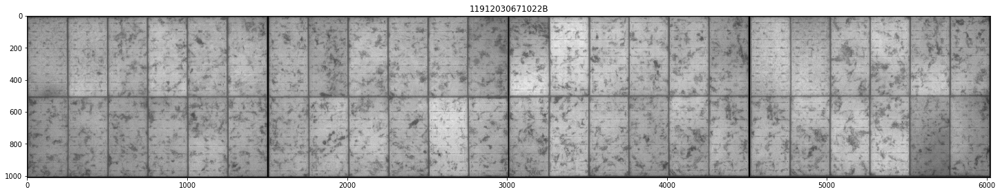

0.5460


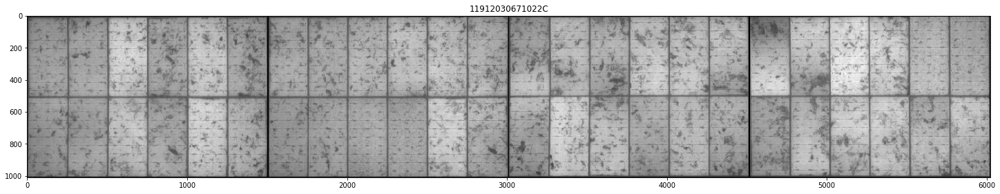

0.5810


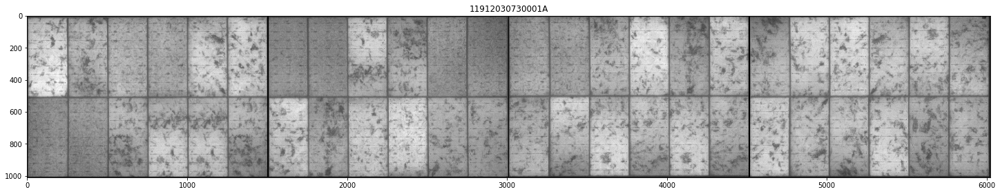

0.5840


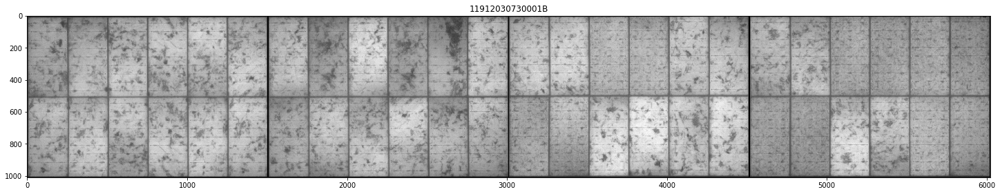

0.5600


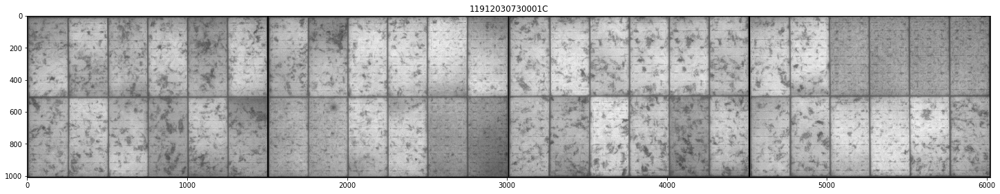

0.5450


In [9]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append(r'D:\slice_join\slice_join\utils')

from concat_pics_longi_V1 import *
import pylab as plt
import time
plt.rc('figure', figsize = (25, 8))

for k, v in pic_dict.items():
    for s in ['A', 'B', 'C']:
        img_list = [cv2.flip(cv2.imread(v['%s%i' % (s, i)]),0) for i in range(1,5)]
        tic = time.time()
        concat_4 = joint_image(img_list, s)
        toc = time.time()
        plt.title(k + s)
        plt.imshow(concat_4, 'gray')
        plt.show()
        print('%.4f' % (toc - tic))
